In [1]:
# import all the libraries
import csv
import re
import string
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure
import seaborn as sns
%matplotlib inline

from nltk.stem import WordNetLemmatizer
from nltk import word_tokenize
from nltk.corpus import stopwords

from sklearn.feature_extraction.text import CountVectorizer
import scipy.sparse
import requests
from bs4 import BeautifulSoup

In [3]:
# upload the data that we want to scrape, which in this case is the one from the 29th of July 2022
all_df = pd.read_csv('test_data.csv')

# remove spaces from the column names
all_df = all_df.rename(columns=lambda x: x.strip())
all_df

,random_id,website,NoPoverty,ZeroHunger,GoodHealth,QualityEducation,GenderEquality,CleanWater,AffordableCleanEnergy,DecentWork,IndustryInnovation,ReduceInequality,SustainableCities,ResponsibleConsumptionProduction,ClimateAction,LifeBelowWater,LifeonLand,PeaceJustice,Partnerships
0,1000000,https://www.law.upenn.edu/faculty/csyoo,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,1000001,https://www.law.upenn.edu/faculty/twolff,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
2,1000002,https://www.law.upenn.edu/faculty/twilkins,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1000003,https://www.law.upenn.edu/faculty/awax/,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0
4,1000004,https://www.law.upenn.edu/faculty/yanbai,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,1000094,https://www.law.upenn.edu/faculty/phrobins,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
95,1000095,https://www.law.upenn.edu/faculty/roberts1,0,0,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0
96,1000096,https://www.gse.upenn.edu/academics/faculty-di...,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1
97,1000097,https://www.gse.upenn.edu/academics/faculty-di...,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1


,0,1
QualityEducation,46.0,53.0
ReduceInequality,55.0,44.0
PeaceJustice,74.0,25.0
GoodHealth,82.0,17.0
DecentWork,88.0,11.0
Partnerships,89.0,10.0
IndustryInnovation,91.0,8.0
GenderEquality,91.0,8.0
SustainableCities,92.0,7.0
NoPoverty,95.0,4.0


<Figure size 1440x1440 with 0 Axes>

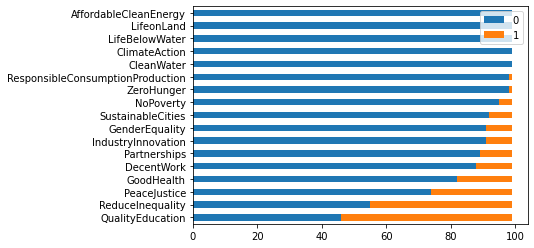

In [4]:
# find the data distribution, 1 vs 0, for every SDG
figure(figsize=(20, 20))

dependent_var = all_df[['NoPoverty', 'ZeroHunger', 'GoodHealth', 'QualityEducation', 'GenderEquality', 'CleanWater', 'AffordableCleanEnergy', 'DecentWork', 'IndustryInnovation',
                        'ReduceInequality', 'SustainableCities', 'ResponsibleConsumptionProduction', 'ClimateAction', 'LifeBelowWater', 'LifeonLand', 'PeaceJustice', 'Partnerships']]
dependent_var_t = dependent_var.apply(pd.Series.value_counts).T.sort_values(by = 0, ascending = True)
dependent_var_t.plot(kind='barh', stacked=True)
dependent_var_t


In [5]:
# create a function to scrape all paragraph from a list of urls/websites
def url_to_transcript(url):
    page = requests.get(url).text
    soup = BeautifulSoup(page, "html.parser")

    # if you want to remove any texts that contains a hyperlink
    # for a in soup.findAll('a', href=True):
    #     a.extract()

    # removing any elements with 'style' and 'script' 
    for script in soup(['style', 'script']):
        script.extract()

    paras_temp = []

    # currently, this my best approach to identify the main text and extract all important points from any given websites
    # however, this method scrape a lot of unimportant texts as well, and in order to minimize the error, I've added text > 100 to make sure only the main paragraphs are being scrapped
    # select all 'div' and 'p' tags that contains more than 100 characters
    for texts in soup.find_all(['div', 'p']):
        if len(texts.text) > 100:
            paras_temp.append(texts.text)
    return paras_temp


In [7]:
# run the scraper function
transcripts = [url_to_transcript(u) for u in all_df['website']]
transcripts


[['\n\n\n\n\n\nFor Alumni\n\n\nFor Students\n\n\nFor Faculty\n\n\nFor Staff\n\n\nLibrary\n\n\n\n\nSupport the Law School\n\nSearch  \nConsumer Information\n          (ABA Required Disclosures)\n\n\n\n',
  '\n\n\n\n\nFor Alumni\n\n\nFor Students\n\n\nFor Faculty\n\n\nFor Staff\n\n\nLibrary\n\n\n\n\nSupport the Law School\n\nSearch  \nConsumer Information\n          (ABA Required Disclosures)\n\n\n',
  '\n\n\n\nFor Alumni\n\n\nFor Students\n\n\nFor Faculty\n\n\nFor Staff\n\n\nLibrary\n\n\n\n\nSupport the Law School\n\nSearch  \nConsumer Information\n          (ABA Required Disclosures)\n\n',
  '\n\n\n\n\n\n\n\n\n\n\nSearch Penn Carey Law  \n\n\n\n\n\nAcademics\n\n\n\n                    A dynamic, cross-disciplinary legal education\n                  \n\nAcademics\xa0\n                  \n\n\n\nDegree Requirements\n\n\nJoint Degrees & Certificates\n\n\nLegal Practice Skills\n\n\nRegistrar\n\n\nClinics & Externships\n\n\nJournals\n\n\nAcademic Support Program\n\n\nInternational Affairs\n\

In [8]:
# make a copy of the list, to make keep the original state in case we need to revert back
transcripts_copy = transcripts.copy()

In [9]:
## here we create a backup file of the raw text from all of the URLs
# assign the transcripts back to the dataframe with all the dependent variables (SDGs)
all_df['transcripts'] = transcripts_copy
all_df_transcripts = all_df[['transcripts', 'NoPoverty', 'ZeroHunger', 'GoodHealth', 'QualityEducation', 'GenderEquality', 'CleanWater', 'AffordableCleanEnergy', 'DecentWork',
                             'IndustryInnovation', 'ReduceInequality', 'SustainableCities', 'ResponsibleConsumptionProduction', 'ClimateAction', 'LifeBelowWater', 'LifeonLand', 'PeaceJustice', 'Partnerships']]

# save the dataframe for backup/checkpoint purposes
# all_df_transcripts.to_pickle('all_data_raw.pkl')
# all_df_transcripts.to_csv('all_data_raw.csv')


In [10]:
# remove all other characters except alphabets, numbers, and punctuation marks ('.', ',', '!', '?')
transcripts_copy = [[re.sub('[^A-Za-z0-9\.\,\!\?]+', ' ', p) for p in lst] for lst in transcripts_copy]
# remove any trailing white spaces
transcripts_copy = [[p.strip() for p in lst] for lst in transcripts_copy]
transcripts_copy

[['For Alumni For Students For Faculty For Staff Library Support the Law School Search Consumer Information ABA Required Disclosures',
  'For Alumni For Students For Faculty For Staff Library Support the Law School Search Consumer Information ABA Required Disclosures',
  'For Alumni For Students For Faculty For Staff Library Support the Law School Search Consumer Information ABA Required Disclosures',
  'Search Penn Carey Law Academics A dynamic, cross disciplinary legal education Academics Degree Requirements Joint Degrees Certificates Legal Practice Skills Registrar Clinics Externships Journals Academic Support Program International Affairs Future of the Profession Initiative Legal Education Programs Academic Calendar Learning Outcomes Advocacy Competitions Admissions Begin your journey Admissions JD Admissions LLM Graduate Programs Master in Law Visiting Penn Carey Law ABA Careers Fostering the professional success of students and alumni Careers For Current Students For Employers Fo

In [11]:
# re-asign the text/transcript to the dataframe after removing all special characters 
all_df['transcripts'] = transcripts_copy
all_df_transcripts = all_df[['transcripts', 'NoPoverty', 'ZeroHunger', 'GoodHealth', 'QualityEducation', 'GenderEquality', 'CleanWater', 'AffordableCleanEnergy', 'DecentWork',
                             'IndustryInnovation', 'ReduceInequality', 'SustainableCities', 'ResponsibleConsumptionProduction', 'ClimateAction', 'LifeBelowWater', 'LifeonLand', 'PeaceJustice', 'Partnerships']]
all_df_transcripts.rename(columns=lambda x: x.strip(), inplace=True)

C:\Users\Admin\AppData\Local\Temp\ipykernel_9560\497616191.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  all_df_transcripts.rename(columns=lambda x: x.strip(), inplace=True)


In [12]:
# preprocess stage: creating functions
# lower all text
def convert_to_lower(text):
    return text.lower()

# remove numbers
def remove_numbers(text):
    number_pattern = r'\d+'
    without_number = re.sub(pattern=number_pattern, repl=" ", string=text)
    return without_number

# to lemmatize text
def lemmatizing(text):
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    for i in range(len(tokens)):
        lemma_word = lemmatizer.lemmatize(tokens[i])
        tokens[i] = lemma_word
    return " ".join(tokens)

# to remove punctuation
def remove_punctuation(text):
    return text.translate(str.maketrans('', '', string.punctuation))

# to remove stopwords
def remove_stopwords(text):
    removed = []
    stop_words = list(stopwords.words("english"))
    tokens = word_tokenize(text)
    for i in range(len(tokens)):
        if tokens[i] not in stop_words:
            removed.append(tokens[i])
    return " ".join(removed)

# to remove trailing white spaces
def remove_extra_white_spaces(text):
    single_char_pattern = r'\s+[a-zA-Z]\s+'
    without_sc = re.sub(pattern=single_char_pattern, repl=" ", string=text)
    return without_sc

# removing text that are less then 3 characters
def remove_2_chr(text):
    non_2_char = []
    tokens = word_tokenize(text)
    for i in range(len(tokens)):
        if len(tokens[i]) > 2:
            non_2_char.append(tokens[i])
    return " ".join(non_2_char)


In [13]:
# apply each of the custom functions from above and re-asign it back to the dataframe
all_df_transcripts['transcripts_join'] = [' '.join(map(str, l)) for l in all_df_transcripts['transcripts']]
all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: convert_to_lower(x))
all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: remove_numbers(x))
all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: remove_punctuation(x))
all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: remove_stopwords(x))
all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: remove_extra_white_spaces(x))
all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: lemmatizing(x))
all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: remove_2_chr(x))
all_df_transcripts.head()

C:\Users\Admin\AppData\Local\Temp\ipykernel_9560\1082687485.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  all_df_transcripts['transcripts_join'] = [' '.join(map(str, l)) for l in all_df_transcripts['transcripts']]
C:\Users\Admin\AppData\Local\Temp\ipykernel_9560\1082687485.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  all_df_transcripts['transcripts_join'] = all_df_transcripts['transcripts_join'].apply(lambda x: convert_to_lower(x))
C:\Users\Admin\AppData\Local\Temp\ipykernel_9560\1082687485.py:

,transcripts,NoPoverty,ZeroHunger,GoodHealth,QualityEducation,GenderEquality,CleanWater,AffordableCleanEnergy,DecentWork,IndustryInnovation,ReduceInequality,SustainableCities,ResponsibleConsumptionProduction,ClimateAction,LifeBelowWater,LifeonLand,PeaceJustice,Partnerships,transcripts_join
0,[For Alumni For Students For Faculty For Staff...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,alumnus student faculty staff library support ...
1,[For Alumni For Students For Faculty For Staff...,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,alumnus student faculty staff library support ...
2,[For Alumni For Students For Faculty For Staff...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,alumnus student faculty staff library support ...
3,[For Alumni For Students For Faculty For Staff...,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,alumnus student faculty staff library support ...
4,[For Alumni For Students For Faculty For Staff...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,alumnus student faculty staff library support ...


In [14]:
# we then use a list of keywords that are related to the SDG goals
# these keywords are compiled from three different sources: Aurora, Leicester Figshare, and SDSN Australia/Pacific
with open("sdg_keywords_aurora_australia_leicester_new.csv", 'r') as f:
  file = csv.reader(f)
  my_list = list(file)
  
sdg_keys = [x for xs in my_list for x in xs]
print(sdg_keys[:10])
print(len(sdg_keys))

['abortion', 'abuse', 'access', 'accident', 'acidic', 'acidification', 'acidity', 'addict', 'adolescence', 'advocates']
559


In [15]:
# remove non SDG keywords from the transcript/text
all_df_transcripts['transcripts_simplified'] = all_df_transcripts['transcripts_join'].apply(lambda x: ' '.join([y for y in x.split() if y in sdg_keys]))
all_df_transcripts['transcripts_simplified']

0     law law law law education skill education law ...
1     law law law law education skill education law ...
2     law law law law education skill education law ...
3     law law law law education skill education law ...
4     law law law law education skill education law ...
                            ...                        
94    law law law law education skill education law ...
95    law law law law education skill education law ...
96    education financial financial resource covid c...
97    education financial financial resource covid a...
98    education financial financial resource covid l...
Name: transcripts_simplified, Length: 99, dtype: object

In [19]:
# remove rows of data that have a blank value for their transcript column
# blanks in this case means that the website/url does not contain any SDG keywords
all_df_transcripts = all_df_transcripts.loc[all_df_transcripts['transcripts_simplified'] != '']
all_df_transcripts.drop(['transcripts','transcripts_join'],axis=1,inplace=True)
all_df_transcripts.drop_duplicates(inplace=True)

In [20]:
# save the final and preprocessed dataframe into a pickle file
# we are going to use this file to augment our class 1 data
# pickle file is basically a raw version of any data, we choose pickle instead of CSV because pickle will retain any format and structure of any given dataframe, whereas CSV does not
all_df_transcripts.to_pickle('all_data_transformed_simplified.pkl')